<a href="https://colab.research.google.com/github/KishoreDT/Easter-Eggs/blob/main/AI_pothole_detection(Video).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorflow-object-detection-api

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
import cv2

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

print(tf.__version__)

2.9.2


## Env setup

In [ ]:
# This is needed to display the images.
%matplotlib inline

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")

## Object detection imports
Here are the imports from the object detection module.

In [ ]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [ ]:
# Our Repo
!git clone https://github.com/arjun-710/AI-pothole-detection.git

Cloning into 'AI-pothole-detection'...
remote: Enumerating objects: 144, done.
remote: Counting objects: 100% (11/11), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 144 (delta 7), reused 4 (delta 4), pack-reused 133
Receiving objects: 100% (144/144), 133.58 MiB | 33.44 MiB/s, done.
Resolving deltas: 100% (49/49), done.
Updating files: 100% (103/103), done.


In [ ]:
%cd AI-pothole-detection

/content/AI-pothole-detection/AI-pothole-detection/AI-pothole-detection


In [ ]:
!ls

'AI_pothole_detection(Image).ipynb'
'AI_pothole_detection(Video).ipynb'
 detect.mp4
 generate_tfrecord.py
 inference_graph
 labelmap.pbtxt
 pothole_testImages
 README.md
 requirements.txt
'Sample Train and Test Images with annotation data'
'TF Records'
 xml_to_csv.py


In [ ]:
cap = cv2.VideoCapture('/content/video.mp4')

# Model preparation 

In [ ]:
MODEL_NAME = '/content/AI-pothole-detection/inference_graph'
PATH_TO_CKPT = MODEL_NAME + '/frozen_inference_graph.pb'
PATH_TO_LABELS = '/content/AI-pothole-detection/labelmap.pbtxt'
NUM_CLASSES = 4

## Load a (frozen) Tensorflow model into memory.

In [ ]:
detection_graph = tf.Graph()

with detection_graph.as_default():
    
    od_graph_def = tf.compat.v1.GraphDef()
    with tf.io.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

In [ ]:
from object_detection.utils import label_map_util
label_map_util.tf = tf.compat.v1
tf.gfile = tf.io.gfile

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [ ]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

## Helper code

In [ ]:
def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
IMAGE_SIZE = (10, 10)

# Detection

In [ ]:
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

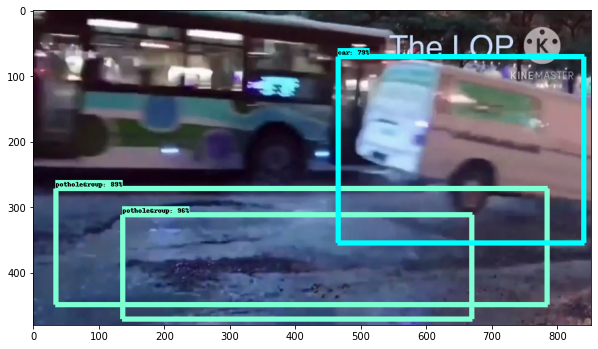

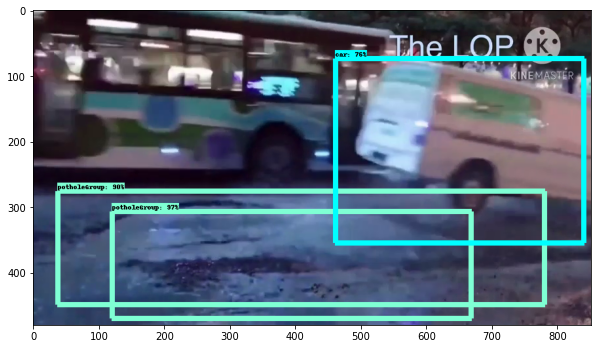

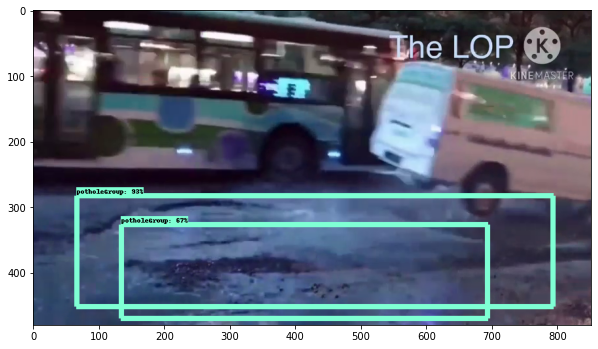

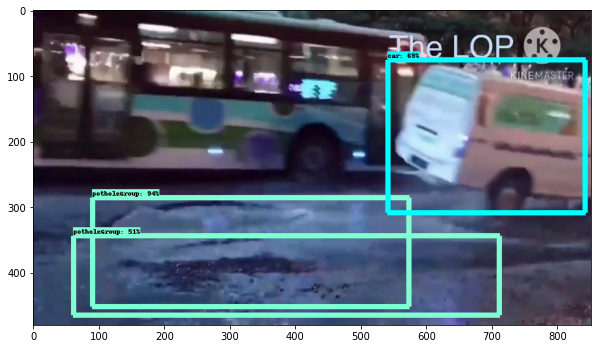

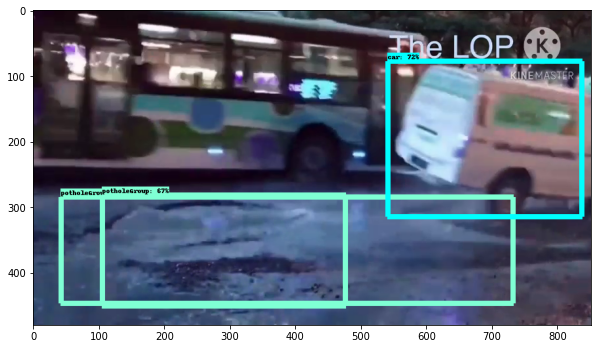

...

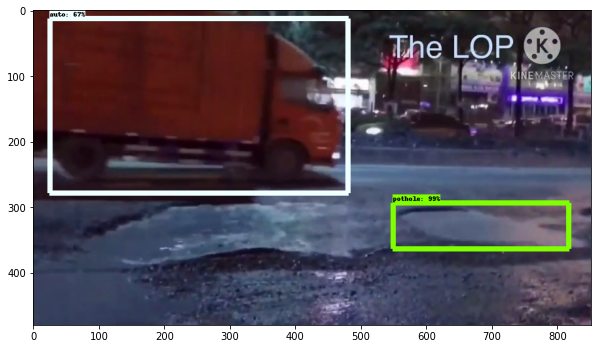

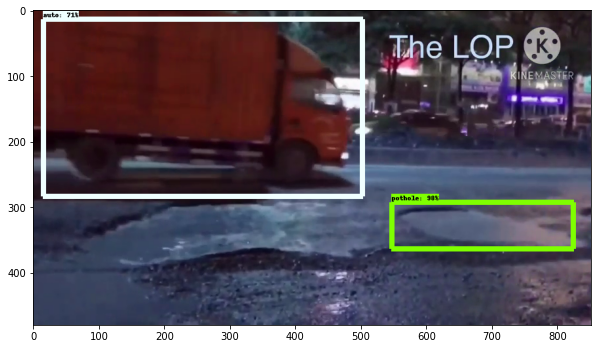

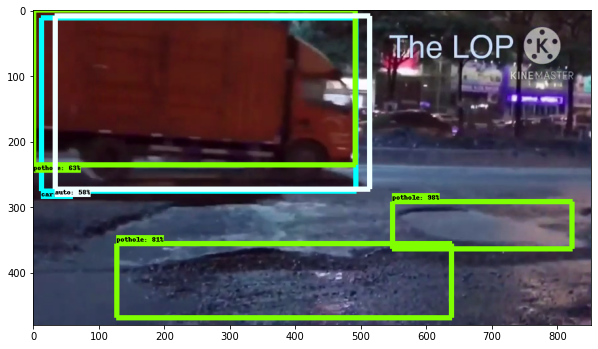

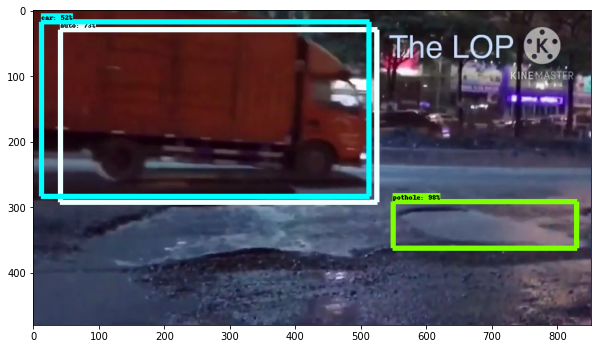

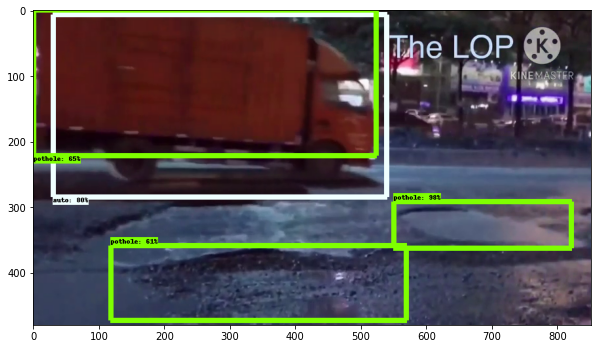

TypeError: ignored

In [ ]:
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        while True:
            ret, image_np = cap.read()
            image_np_expanded = np.expand_dims(image_np, axis=0)
            image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
            boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
            scores = detection_graph.get_tensor_by_name('detection_scores:0')
            classes = detection_graph.get_tensor_by_name('detection_classes:0')
            num_detections = detection_graph.get_tensor_by_name('num_detections:0')

            (boxes, scores, classes, num_detections) = sess.run(
                [boxes, scores, classes, num_detections],
                feed_dict={image_tensor: image_np_expanded})
            
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                np.squeeze(classes).astype(np.int32),
                np.squeeze(scores),
                category_index,
                use_normalized_coordinates=True,
                line_thickness=8)
            
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)
            plt.show()
            cv2.waitKey(0)
            if not ret:
              break